

# Report on the Analysis of SussexBudgetProductions Movie Production



The purpose  of analysis is to be able to identify the key variables that cause low return  recorded in the  production of comedy-action-thriller. This will help us  to identify the key variables responsible for high and low return on investment from  movie production. and finally help make inform descision in genre movie selection.

The report is  generated after analysing the IMDB dataset. This datasets contains importants variables of past movies produced by SussexBudgetProductions.We will conduct an  Exploratory Data Analysis on the dataset to gain some insight from the dataset and also  propose an (hypothesis) explanation for  observation recorded from our anlysis.



In [1]:
#importing neccesary manupulative libraries

import numpy as np
import pandas as pd

#Importing some necessary visualisation libraries 
import matplotlib.pyplot as plt

from pandas_profiling import ProfileReport

import seaborn as sns
%matplotlib inline

In [2]:
#importing data set and Reading the dataframe in pandas

data = pd.read_csv('movie_metadata.csv')

data.head() #callin out the first 5 rows

,color,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,...,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes
0,Color,James Cameron,723.0,178.0,0.0,855.0,Joel David Moore,1000.0,760505847.0,Action|Adventure|Fantasy|Sci-Fi,...,3054.0,English,USA,PG-13,237000000.0,2009.0,936.0,7.9,1.78,33000
1,Color,Gore Verbinski,302.0,169.0,563.0,1000.0,Orlando Bloom,40000.0,309404152.0,Action|Adventure|Fantasy,...,1238.0,English,USA,PG-13,300000000.0,2007.0,5000.0,7.1,2.35,0
2,Color,Sam Mendes,602.0,148.0,0.0,161.0,Rory Kinnear,11000.0,200074175.0,Action|Adventure|Thriller,...,994.0,English,UK,PG-13,245000000.0,2015.0,393.0,6.8,2.35,85000
3,Color,Christopher Nolan,813.0,164.0,22000.0,23000.0,Christian Bale,27000.0,448130642.0,Action|Thriller,...,2701.0,English,USA,PG-13,250000000.0,2012.0,23000.0,8.5,2.35,164000
4,NaN,Doug Walker,NaN,NaN,131.0,NaN,Rob Walker,131.0,NaN,Documentary,...,NaN,NaN,NaN,NaN,NaN,NaN,12.0,7.1,NaN,0


# Exploratory data analysis

In [3]:
#Checking for row and column in our dataset

data.shape

(5043, 28)

#### Our IMDB datasets contain 5045 rows and 28 columns

In [4]:
#Checking for categorical and numeric variables in our datasets

data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5043 entries, 0 to 5042
Data columns (total 28 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   color                      5024 non-null   object 
 1   director_name              4939 non-null   object 
 2   num_critic_for_reviews     4993 non-null   float64
 3   duration                   5028 non-null   float64
 4   director_facebook_likes    4939 non-null   float64
 5   actor_3_facebook_likes     5020 non-null   float64
 6   actor_2_name               5030 non-null   object 
 7   actor_1_facebook_likes     5036 non-null   float64
 8   gross                      4159 non-null   float64
 9   genres                     5043 non-null   object 
 10  actor_1_name               5036 non-null   object 
 11  movie_title                5043 non-null   object 
 12  num_voted_users            5043 non-null   int64  
 13  cast_total_facebook_likes  5043 non-null   int64

In [5]:
# Creating a Variable for all numerical variable
data_num=data._get_numeric_data()
data_num.columns.shape

(16,)

 Our datasets have 16 numeric variables and 12 categorical variables

In [6]:
#Carrying out a correlation among variables to establish strenght of relationship among varaibles

data_num = data_num.corr()
data_num

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,gross,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,num_user_for_reviews,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes
num_critic_for_reviews,1.000000,0.258486,0.180674,0.271646,0.190016,0.480601,0.624943,0.263203,-0.033897,0.609387,0.119994,0.275707,0.282306,0.305303,-0.049786,0.683176
duration,0.258486,1.000000,0.173296,0.123558,0.088449,0.250298,0.314765,0.123074,0.013469,0.328403,0.074276,-0.135038,0.131673,0.261662,-0.090071,0.196605
director_facebook_likes,0.180674,0.173296,1.000000,0.120199,0.090723,0.144945,0.297057,0.119549,-0.041268,0.221890,0.021090,-0.063820,0.119601,0.170802,0.001642,0.162048
actor_3_facebook_likes,0.271646,0.123558,0.120199,1.000000,0.249927,0.308026,0.287239,0.473920,0.099368,0.230189,0.047451,0.096137,0.559662,0.052633,-0.003366,0.278844
actor_1_facebook_likes,0.190016,0.088449,0.090723,0.249927,1.000000,0.154468,0.192804,0.951661,0.072257,0.145461,0.022639,0.086873,0.390487,0.076099,-0.020049,0.135348
gross,0.480601,0.250298,0.144945,0.308026,0.154468,1.000000,0.637271,0.247400,-0.027755,0.559958,0.102179,0.030886,0.262768,0.198021,0.069346,0.378082
num_voted_users,0.624943,0.314765,0.297057,0.287239,0.192804,0.637271,1.000000,0.265911,-0.026998,0.798406,0.079621,0.007397,0.270790,0.410965,-0.014761,0.537924
cast_total_facebook_likes,0.263203,0.123074,0.119549,0.473920,0.951661,0.247400,0.265911,1.000000,0.091475,0.206923,0.036557,0.109971,0.628404,0.085787,-0.017885,0.209786
facenumber_in_poster,-0.033897,0.013469,-0.041268,0.099368,0.072257,-0.027755,-0.026998,0.091475,1.000000,-0.069018,-0.019559,0.061504,0.071228,-0.062958,0.013713,0.008918
num_user_for_reviews,0.609387,0.328403,0.221890,0.230189,0.145461,0.559958,0.798406,0.206923,-0.069018,1.000000,0.084292,-0.003147,0.219496,0.292475,-0.024719,0.400594


<AxesSubplot:>

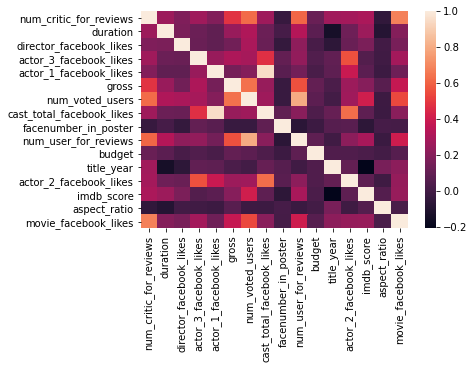

In [7]:
sns.heatmap(data_num)

In [8]:
#using the profile report method to get the summary statistics of our dataset

data.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

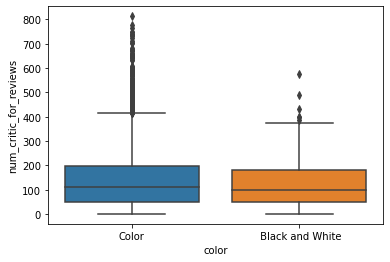

In [36]:
#Creating a Visualisation of features to check relation among varaibles
sns.boxplot(x = "color", y = "num_critic_for_reviews", data = data);

The boxplot above shows that while there are higher number of critic for reviews for the colour, the median values for both color and black and while looks almost the same. 

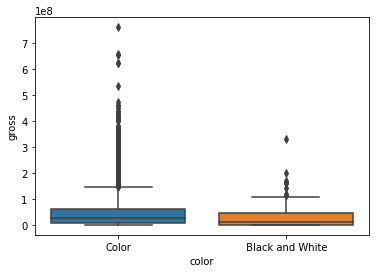

In [38]:
sns.boxplot(x = "color", y = "gross", data = data);

From our dataset we discoverd  5043 total entries or data point recorded  with a total  28 variables of which 16 variables is numeric while 12 variables is categorical.

We will creating a sample by filtering our dataset based on some desirable selection criteria. We are more intrested on movie with high rating. i.e rating that is 8 that is within our production budgetn 



In [77]:
genreseries=data.groupby('genres')['imdb_score','budget'].mean()
# We have set the minimum imdb score to 8 here to focus on only high score 
min_imdb_score=6
top_rated_genre = genreseries[genreseries['imdb_score']>min_imdb_score] #filtring our top rates movie
top_rated_genre = top_rated_genre.sort_values('imdb_score', ascending=False) #sorting our score from highest to lowest
#printing the first 5 row of  genres for inspection
top_rated_genre.head()


<ipython-input-77-61e7ebcb1d58>:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  genreseries=data.groupby('genres')['imdb_score','budget'].mean()


,imdb_score,budget
genres,,
Action|Adventure|Crime|Drama|Sci-Fi|Thriller,8.8,NaN
Action|Adventure|Biography|Drama|History,8.6,NaN
Action|Drama|History|Thriller|War,8.5,4400000.0
Crime|Drama|Fantasy|Mystery,8.5,60000000.0
Adventure|Animation|Drama|Family|Musical,8.5,45000000.0


In [78]:
#inspecting the last 5 row of genre for inspection
top_rated_genre.tail()

,imdb_score,budget
genres,,
Comedy|Drama|Musical,6.050000,6.500000e+06
Comedy|Musical|Romance,6.042857,6.181467e+06
Action|Adventure|Horror|Sci-Fi,6.025000,4.750000e+07
Comedy|Music,6.023529,1.657667e+07
Fantasy|Horror|Thriller,6.020000,1.195000e+07


In [79]:
#The maximum possible is set to  500,000 based on the expected fund expected from investors
max_budget = 500000
topgenreseries=data.groupby('genres')['imdb_score','budget','gross'].mean()
#Checking for movie details within budgeti.e less than 1.5M
budget_genres = topgenreseries[topgenreseries['budget']<max_budget]
budget_genres = budget_genres.sort_values('imdb_score',ascending=False)
budget_genres.head()

<ipython-input-79-56113c7fa6c1>:3: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  topgenreseries=data.groupby('genres')['imdb_score','budget','gross'].mean()


,imdb_score,budget,gross
genres,,,
Documentary|Family,8.200,125000.0,NaN
Crime|Documentary,8.000,200000.0,2156472.5
Documentary|History|Music,7.800,400000.0,6757592.5
Biography|Documentary|Music,7.525,300000.0,6531469.5
Biography|Documentary,7.300,25109.0,592014.0


In [54]:
#The maximum possible is set to  1,500,000 based on the expected fund expected from investors
max_budget = 1500000
topgenreseries=data.groupby('genres')['imdb_score','budget','gross'].mean()
#Checking for movie details within budgeti.e less than 1.5M
budget_genres = topgenreseries[topgenreseries['budget']<max_budget]
budget_genres = budget_genres.sort_values('imdb_score',ascending=False)
budget_genres.head()

<ipython-input-54-1ddba9646e3c>:3: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  topgenreseries=data.groupby('genres')['imdb_score','budget','gross'].mean()


,imdb_score,budget,gross
genres,,,
Documentary|Drama|Sport,8.3,700000.0,7830611.0
Documentary|Family,8.2,125000.0,NaN
Drama|Film-Noir|Mystery|Thriller,8.2,1288000.0,NaN
Biography|Crime|Documentary|History,8.2,1000000.0,484221.0
Thriller|Western,8.1,750000.0,NaN


In [ ]:
#When the maximum possible is set to  1,500,000 based on the expected fund expected from investors
max_budget = 1500000
topgenreseries=data.groupby('genres')['imdb_score','budget','gross'].mean()
#Checking for movie details within budgeti.e less than 1.5M
budget_genres = topgenreseries[topgenreseries['budget']<max_budget]
budget_genres = budget_genres.sort_values('imdb_score',ascending=False)
budget_genres.head()

The Documentary|Family genre appers to have a good rating within a  budget of 500000 while Documentary|Drama|Sport appears to be well rated wihin a budget of 1.5 million . Taking a look at the details more closely we can see that there is actually only one film that meets the criteria of budget and imdb rating:

In [4]:
data[data['genres']=='Documentary|Family']


,color,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,...,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes
4945,Color,Amal Al-Agroobi,NaN,62.0,58.0,NaN,NaN,NaN,NaN,Documentary|Family,...,NaN,Arabic,United Arab Emirates,NaN,125000.0,2013.0,NaN,8.2,NaN,54


In [80]:
data[data['genres']=='Documentary|Drama|Sport']

,color,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,...,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes,return_on_invest,return_invest
4688,Color,Steve James,53.0,170.0,23.0,2.0,Arthur Agee,7.0,7830611.0,Documentary|Drama|Sport,...,USA,PG-13,700000.0,1994.0,6.0,8.3,1.33,0,11.186587,11.186587


# Hypothesis formulating and Testing
 
 
 ## Variable Description and Dictionary

###### IMDB SCORE

According to IMDb, the  IMDb score is gotten from registered users that cast a vote (from 1 to 10) on every released title in the database.  Individual votes are therefore aggregated and summarized as a single IMDb rating, visible on the title's main page. 

###### MOVIE GENRES

style and category of movies


##### Content rating

Content rating based on Audience viewership


#### Gross

Sales made from films



 
 
 
#### Independent variables: IMDB score, Movie genre, Content rating

#### Dependent Variable: 'gross' or return on investment 



## Hypothesis
IMDb score and Movie genres affects return on investment.


## Hypthesis testing 
High IMDb score causes high return on investment and coversly low IMDb score causes low return on investment

Movie genres such with 'documentary' generally have high IMDB score for example Documentary|Family, Documentary|Drama|Sport were rated high in IMDB score 


Independent variables: IMDB score, Movie genre, Content rating

Dependent Variable: 'gross' or return on investment 

# Feature Engineeering 


We created in a new feature from existing variable


The new variable  we created is 'return_on_invest'. The reason is to get the return on investment. We compute this new variable by dividing the  'gross'  by 'budget'.

'gross' represent Investment Gain 
'budget' represent Investment Base

ROI = Investment Gain / Investment Base


In [74]:
#Creating return on Investment

data['return_invest'] = (data['gross']  / data['budget'])



In [76]:
data.sort_values('return_on_invest', ascending=False )

,color,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,...,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes,return_on_invest,return_invest
4793,Color,Oren Peli,409.0,84.0,110.0,21.0,Ashley Palmer,189.0,107917283.0,Horror,...,USA,R,15000.0,2007.0,109.0,6.3,1.85,12000,7194.485533,7194.485533
4799,Color,Jonathan Caouette,72.0,88.0,20.0,0.0,Jonathan Caouette,58.0,592014.0,Biography|Documentary,...,USA,Unrated,218.0,2003.0,20.0,7.2,1.37,754,2715.660550,2715.660550
4707,Black and White,Daniel Myrick,360.0,81.0,19.0,39.0,Joshua Leonard,170.0,140530114.0,Horror,...,USA,R,60000.0,1999.0,170.0,6.4,1.33,0,2342.168567,2342.168567
4984,Color,Edward Burns,36.0,98.0,0.0,73.0,Michael McGlone,138.0,10246600.0,Comedy|Drama|Romance,...,USA,R,25000.0,1995.0,111.0,6.6,1.85,265,409.864000,409.864000
4936,Color,Tobe Hooper,277.0,88.0,365.0,177.0,Edwin Neal,383.0,30859000.0,Horror|Thriller,...,USA,R,83532.0,1974.0,371.0,7.5,1.85,0,369.427285,369.427285
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5036,Color,Anthony Vallone,NaN,84.0,2.0,2.0,John Considine,45.0,NaN,Crime|Drama,...,USA,PG-13,3250.0,2005.0,44.0,7.8,NaN,4,NaN,NaN
5038,Color,Scott Smith,1.0,87.0,2.0,318.0,Daphne Zuniga,637.0,NaN,Comedy|Drama,...,Canada,NaN,NaN,2013.0,470.0,7.7,NaN,84,NaN,NaN
5039,Color,NaN,43.0,43.0,NaN,319.0,Valorie Curry,841.0,NaN,Crime|Drama|Mystery|Thriller,...,USA,TV-14,NaN,NaN,593.0,7.5,16.00,32000,NaN,NaN
5040,Color,Benjamin Roberds,13.0,76.0,0.0,0.0,Maxwell Moody,0.0,NaN,Drama|Horror|Thriller,...,USA,NaN,1400.0,2013.0,0.0,6.3,NaN,16,NaN,NaN


In [73]:


movie_gross=data.loc[:,['genres','imdb_score','return_on_invest']] # make dataframe with just genres and budget data

counts=movie_gross.groupby('genres').count().reset_index('genres') # get the frequencies count
counts.sort_values('return_on_invest', ascending= False)


#=8 #set the number we consider to be 'big' in terms of films made so that we can plot just a reasonable number of countries here

#bigcounts=counts[counts.gross>n]['genres'] # make index by frequency
#bigcountries_df = movie_gross[country_budgets.country.isin(bigcounts)] # use frequency index to make new dataframe with just 'big countries'
#bigcountries_df.boxplot(by='country',figsize=(8,5)) # plot it




,genres,imdb_score,return_on_invest
767,Drama,236,154
638,Comedy|Drama|Romance,187,151
605,Comedy|Drama,191,148
569,Comedy,209,147
696,Comedy|Romance,158,136
...,...,...,...
790,Drama|Fantasy|Mystery|Sci-Fi,1,0
116,Action|Adventure|Mystery|Romance|Thriller,1,0
420,Adventure|Drama|Fantasy|Thriller|Western,1,0
57,Action|Adventure|Crime|Drama,1,0


Go on here and do further exploratory analyses and some appropriate statistical analyses on appropriate hypotheses...

# Conclusion




I analysed the imdb data file to get insight on the best movie  to recommend for good return on investment for the next SussexBudgetProductions Movie Production within our proposed budget.



I discovered that the films of the genre 'Documentary|Drama|Sport' met the criteria of budget 1.5million while the film with genre "Documentary and Family" met the criteria of budget 500000. although, both only have a single example of this type of movie which makes it weak to generalised from these inferences.

However, we observed that films that gives the highest return are those IMDB rating greater than or equal to (6) which have content rating of R or unrated.

Based on the Analatysis carried out. I have come up with some recommendation that SussexBudgetProductions can focus on horror  movie made from USA released to youth & Adult demography because this will bring the highest return

Secondly, SussexBudgetProductions should also focus  on family friendly documentary with sport and drama. Although, our record here is based on single film which is not sufficient for generalisation.


